<a href="https://colab.research.google.com/github/Jessica-Emereuwa/GoMyCode-DataScience/blob/main/Streamlit_checkpoint_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
"""

What You're Aiming For




Instructions

Install the necessary packages
Import you data and perform basic data exploration phase
Display general information about the dataset
Create a pandas profiling reports to gain insights into the dataset
Handle Missing and corrupted values
Remove duplicates, if they exist
Handle outliers, if they exist
Encode categorical features
Based on the previous data exploration train and test a machine learning classifier
Create a streamlit application (locally)
Add input fields for your features and a validation button at the end of the form
Import your ML model into the streamlit application and start making predictions given the provided features values
Note:

This checkpoint should be done locally, (Google colab notebooks won't work)
Make sure to run the app using the "streamlit run" command in your terminal.
"""

In [1]:
import pandas as pd

#Load the dataset
data = pd.read_csv('Expresso_churn_dataset.csv')
data.head()

,user_id,REGION,TENURE,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,MRG,REGULARITY,TOP_PACK,FREQ_TOP_PACK,CHURN
0,00000bfd7d50f01092811bc0c8d7b0d6fe7c3596,FATICK,K > 24 month,4250.0,15.0,4251.0,1417.0,17.0,4.0,388.0,46.0,1.0,1.0,2.0,NO,54,On net 200F=Unlimited _call24H,8.0,0
1,00000cb4a5d760de88fecb38e2f71b7bec52e834,NaN,I 18-21 month,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NO,4,NaN,NaN,1
2,00001654a9d9f96303d9969d0a4a851714a4bb57,NaN,K > 24 month,3600.0,2.0,1020.0,340.0,2.0,NaN,90.0,46.0,7.0,NaN,NaN,NO,17,On-net 1000F=10MilF;10d,1.0,0
3,00001dd6fa45f7ba044bd5d84937be464ce78ac2,DAKAR,K > 24 month,13500.0,15.0,13502.0,4501.0,18.0,43804.0,41.0,102.0,2.0,NaN,NaN,NO,62,"Data:1000F=5GB,7d",11.0,0
4,000028d9e13a595abe061f9b58f3d76ab907850f,DAKAR,K > 24 month,1000.0,1.0,985.0,328.0,1.0,NaN,39.0,24.0,NaN,NaN,NaN,NO,11,Mixt 250F=Unlimited_call24H,2.0,0


In [2]:
# Display general information about the dataset
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2154048 entries, 0 to 2154047
Data columns (total 19 columns):
 #   Column          Dtype  
---  ------          -----  
 0   user_id         object 
 1   REGION          object 
 2   TENURE          object 
 3   MONTANT         float64
 4   FREQUENCE_RECH  float64
 5   REVENUE         float64
 6   ARPU_SEGMENT    float64
 7   FREQUENCE       float64
 8   DATA_VOLUME     float64
 9   ON_NET          float64
 10  ORANGE          float64
 11  TIGO            float64
 12  ZONE1           float64
 13  ZONE2           float64
 14  MRG             object 
 15  REGULARITY      int64  
 16  TOP_PACK        object 
 17  FREQ_TOP_PACK   float64
 18  CHURN           int64  
dtypes: float64(12), int64(2), object(5)
memory usage: 312.2+ MB


In [3]:
# Summary statistics of the dataset
data.describe()

,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,REGULARITY,FREQ_TOP_PACK,CHURN
count,1.397309e+06,1.397309e+06,1.428000e+06,1.428000e+06,1.428000e+06,1.093615e+06,1.367373e+06,1.258800e+06,864032.000000,169721.000000,136824.000000,2.154048e+06,1.251454e+06,2.154048e+06
mean,5.532117e+03,1.152912e+01,5.510810e+03,1.836943e+03,1.397814e+01,3.366450e+03,2.776891e+02,9.541871e+01,23.109253,8.170132,7.553309,2.804251e+01,9.272461e+00,1.875474e-01
std,7.111339e+03,1.327407e+01,7.187113e+03,2.395700e+03,1.469403e+01,1.330446e+04,8.726889e+02,2.049873e+02,63.578086,41.169511,33.487234,2.228686e+01,1.228044e+01,3.903504e-01
min,1.000000e+01,1.000000e+00,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,1.000000e+00,1.000000e+00,0.000000e+00
25%,1.000000e+03,2.000000e+00,1.000000e+03,3.330000e+02,3.000000e+00,0.000000e+00,5.000000e+00,7.000000e+00,2.000000,0.000000,0.000000,6.000000e+00,2.000000e+00,0.000000e+00
50%,3.000000e+03,7.000000e+00,3.000000e+03,1.000000e+03,9.000000e+00,2.570000e+02,2.700000e+01,2.900000e+01,6.000000,1.000000,2.000000,2.400000e+01,5.000000e+00,0.000000e+00
75%,7.350000e+03,1.600000e+01,7.368000e+03,2.456000e+03,2.000000e+01,2.895000e+03,1.560000e+02,9.900000e+01,20.000000,3.000000,5.000000,5.100000e+01,1.200000e+01,0.000000e+00
max,4.700000e+05,1.330000e+02,5.321770e+05,1.773920e+05,9.100000e+01,1.823866e+06,5.080900e+04,2.132300e+04,4174.000000,4792.000000,3697.000000,6.200000e+01,7.130000e+02,1.000000e+00


In [ ]:
!pip install ydata-profiling

In [5]:
#Create a pandas profiling reports to gain insights into the dataset
from ydata_profiling import ProfileReport

profile = ProfileReport(data, title="Expresso Churn", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
#Handle Missing and corrupted values

data.isnull().sum()

user_id                 0
REGION             849299
TENURE                  0
MONTANT            756739
FREQUENCE_RECH     756739
REVENUE            726048
ARPU_SEGMENT       726048
FREQUENCE          726048
DATA_VOLUME       1060433
ON_NET             786675
ORANGE             895248
TIGO              1290016
ZONE1             1984327
ZONE2             2017224
MRG                     0
REGULARITY              0
TOP_PACK           902594
FREQ_TOP_PACK      902594
CHURN                   0
dtype: int64

In [7]:
# Handle Missing and corrupted values
# Fill missing numerical values with the mean
for column in data.select_dtypes(include=['number']):
    data[column].fillna(data[column].mean(), inplace=True)

# Check for remaining missing values
data.isnull().sum()

user_id                0
REGION            849299
TENURE                 0
MONTANT                0
FREQUENCE_RECH         0
REVENUE                0
ARPU_SEGMENT           0
FREQUENCE              0
DATA_VOLUME            0
ON_NET                 0
ORANGE                 0
TIGO                   0
ZONE1                  0
ZONE2                  0
MRG                    0
REGULARITY             0
TOP_PACK          902594
FREQ_TOP_PACK          0
CHURN                  0
dtype: int64

In [8]:
# Replace the categorical missing values with mode

data.fillna(data.mode().iloc[0], inplace=True)

In [9]:
data.isnull().sum()

user_id           0
REGION            0
TENURE            0
MONTANT           0
FREQUENCE_RECH    0
REVENUE           0
ARPU_SEGMENT      0
FREQUENCE         0
DATA_VOLUME       0
ON_NET            0
ORANGE            0
TIGO              0
ZONE1             0
ZONE2             0
MRG               0
REGULARITY        0
TOP_PACK          0
FREQ_TOP_PACK     0
CHURN             0
dtype: int64

In [10]:
#Remove duplicates values, if they exist
data.duplicated().sum()

0

In [15]:


# Function to remove outliers in specified columns
def remove_outliers(data, columns):
    for column in columns:
        Q1 = data[column].quantile(0.25)
        Q3 = data[column].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        data = data[(data[column] >= lower_bound) & (data[column] <= upper_bound)]
    return data


In [16]:
# Specify the columns where you want to remove outliers
columns_to_check = ['MONTANT',	'FREQUENCE_RECH',	'REVENUE',	'ARPU_SEGMENT',	'FREQUENCE',	'DATA_VOLUME',	'ON_NET',	'ORANGE',	'TIGO',	'ZONE1',	'ZONE2',	'FREQ_TOP_PACK', 'REGULARITY']

# Remove outliers in the specified columns
df_cleaned = remove_outliers(data, columns_to_check)

# Display the cleaned DataFrame
df_cleaned.describe()

,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,REGULARITY,FREQ_TOP_PACK,CHURN
count,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06,1.157112e+06
mean,4.087525e+03,8.691031e+00,3.972544e+03,1.324190e+03,1.047941e+01,2.452928e+03,1.867185e+02,7.528561e+01,2.292219e+01,8.170132e+00,7.553309e+00,1.417716e+01,7.450368e+00,3.182043e-01
std,2.139729e+03,4.360463e+00,2.196993e+03,7.323256e+02,5.304358e+00,1.501311e+03,1.277805e+02,3.726099e+01,1.312917e+00,0.000000e+00,3.552715e-15,1.523190e+01,3.225184e+00,4.657795e-01
min,1.000000e+01,1.000000e+00,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.300000e+01,8.170132e+00,7.553309e+00,1.000000e+00,1.000000e+00,0.000000e+00
25%,1.700000e+03,4.000000e+00,1.500000e+03,5.000000e+02,5.000000e+00,6.710000e+02,1.700000e+01,5.900000e+01,2.310925e+01,8.170132e+00,7.553309e+00,2.000000e+00,6.000000e+00,0.000000e+00
50%,5.532117e+03,1.152912e+01,5.510810e+03,1.836943e+03,1.397814e+01,3.366450e+03,2.776891e+02,9.541871e+01,2.310925e+01,8.170132e+00,7.553309e+00,7.000000e+00,9.272461e+00,0.000000e+00
75%,5.532117e+03,1.152912e+01,5.510810e+03,1.836943e+03,1.397814e+01,3.366450e+03,2.776891e+02,9.541871e+01,2.310925e+01,8.170132e+00,7.553309e+00,2.200000e+01,9.272461e+00,1.000000e+00
max,1.080000e+04,2.200000e+01,1.151300e+04,3.838000e+03,2.700000e+01,8.108000e+03,6.770000e+02,2.100000e+02,2.900000e+01,8.170132e+00,7.553309e+00,5.700000e+01,1.500000e+01,1.000000e+00


In [17]:
from sklearn.preprocessing import LabelEncoder

# Initialize LabelEncoder
le = LabelEncoder()

# Apply LabelEncoder to each categorical feature
for col in df_cleaned.select_dtypes(include=['object']).columns:
    df_cleaned[col] = le.fit_transform(df_cleaned[col])


In [18]:
# Display the transformed dataset
df_cleaned.head()

,user_id,REGION,TENURE,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,MRG,REGULARITY,TOP_PACK,FREQ_TOP_PACK,CHURN
1,0,0,5,5532.116998,11.52912,5510.810334,1836.942894,13.978141,3366.450167,277.68914,95.418711,23.109253,8.170132,7.553309,0,4,12,9.272461,1
4,1,0,7,1000.000000,1.00000,985.000000,328.000000,1.000000,3366.450167,39.00000,24.000000,23.109253,8.170132,7.553309,0,11,83,2.000000,0
6,2,7,7,5532.116998,11.52912,5510.810334,1836.942894,13.978141,3366.450167,277.68914,95.418711,23.109253,8.170132,7.553309,0,2,12,9.272461,0
10,3,0,7,200.000000,1.00000,5510.810334,1836.942894,13.978141,3366.450167,277.68914,95.418711,23.109253,8.170132,7.553309,0,1,12,9.272461,0
12,4,0,3,5532.116998,11.52912,5510.810334,1836.942894,13.978141,3366.450167,277.68914,95.418711,23.109253,8.170132,7.553309,0,2,12,9.272461,1


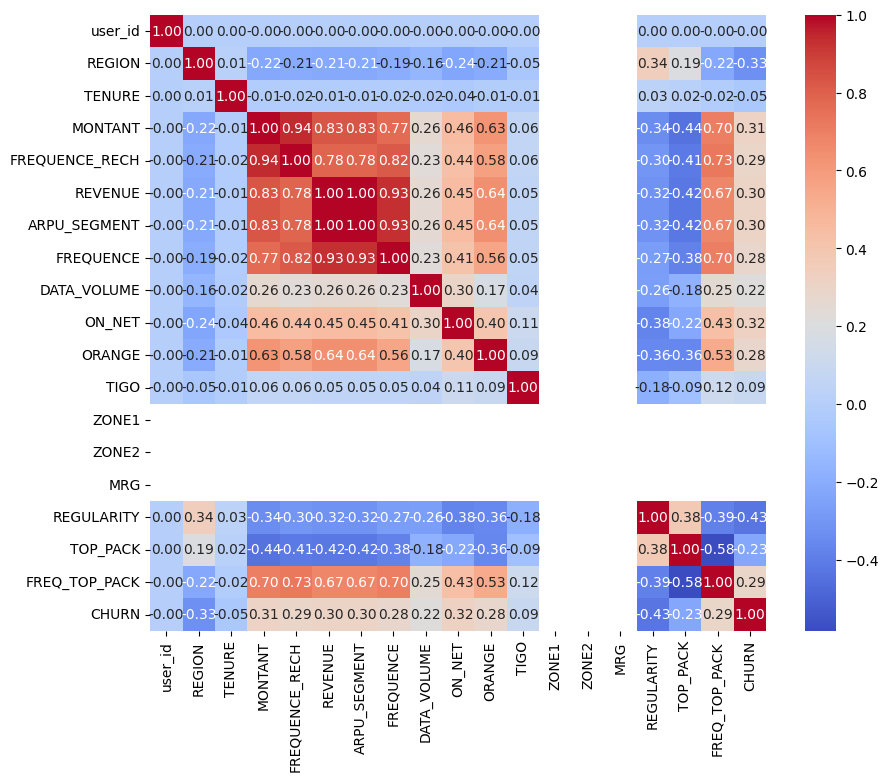

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate the correlation matrix
corr = df_cleaned.corr()

# Create a heatmap
plt.figure(figsize=(10, 8))  # You can adjust the size of the figure
sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm', cbar=True, square=True)

plt.show()

In [36]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Splitting the dataset
X = df_cleaned.drop(['CHURN', 'ZONE1','ZONE2','MRG','TIGO','TOP_PACK','ON_NET','REGION', 'TENURE', 'user_id', 'DATA_VOLUME'], axis=1)
y = df_cleaned['CHURN']


In [37]:
y.value_counts()

CHURN
0    788914
1    368198
Name: count, dtype: int64

In [38]:
# Split the data into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [40]:
# Training the classifier
clf = RandomForestClassifier()
clf.fit(X_train, y_train)


RandomForestClassifier()

In [41]:
# Making predictions
y_pred = clf.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")


Accuracy: 0.7705802794017881


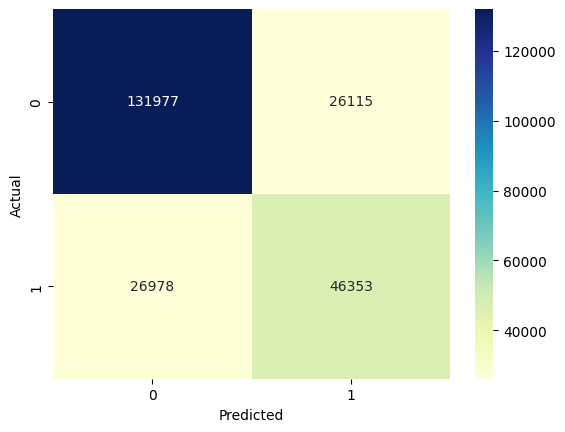

In [42]:
from sklearn.metrics import confusion_matrix

# Confusion Matrix
cm = confusion_matrix(y_test,  y_pred)  # Now confusion_matrix is defined
sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu')
plt.ylabel('Actual')
plt.xlabel('Predicted')
plt.show()

In [43]:

# Save the model
import pickle

with open('churn_model.pkl', 'wb') as file:
    pickle.dump(clf, file)

In [44]:
!pip install streamlit

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 14.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 20.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 38.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.0/83.0 kB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.5 MB/s eta 0:00:00


In [68]:
%%writefile app.py

import pickle
import streamlit as st
import numpy as np

# Title of the application
st.title('Client Churn Probability')

# Load the trained machine learning model
def load_model():
    with open('churn_model.pkl', 'rb') as model_file:
        model = pickle.load(model_file)
    return model
model = load_model()

# Input fields for features
feature1 = st.text_input('MONTANT', '1000')
feature2 = st.slider('REGULARITY', 0, 100, 50)
feature3 = st.text_input('FREQ_TOP_PACK', '10')

# Validation button
if st.button('Validate'):
    # Validation logic
    st.write('Feature 1:', feature1)
    st.write('Feature 2:', feature2)
    st.write('Feature 3:', feature3)
    st.write('Validation complete!')

# Prediction button
if st.button('Predict'):
    try:
        # Convert input features to float
        features = [float(feature1), float(feature2), float(feature3)]

        # Make predictions
        prediction = model.predict(np.array(features).reshape(1, -1))

        # Display prediction
        st.write('Prediction:', prediction[0])
    except ValueError as e:
        st.write(f'Error: {e}')


Overwriting app.py


In [69]:
!npm install localtunnel


up to date, audited 23 packages in 566ms

3 packages are looking for funding
  run `npm fund` for details

2 moderate severity vulnerabilities

To address all issues (including breaking changes), run:
  npm audit fix --force

Run `npm audit` for details.


In [ ]:
!streamlit run app.py & npx localtunnel --port 8501 & curl -s ipv4.icanhazip.com

34.138.207.220



  You can now view your Streamlit app in your browser.

  Local URL: http://localhost:8501
  Network URL: http://172.28.0.12:8501
  External URL: http://34.138.207.220:8501

your url is: https://tame-eagles-film.loca.lt
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
